## Viburnum Oreinotinus PCAs
And other dimensionality reduction methods.

In [1]:
import pandas as pd
import toyplot
import toyplot.png
import ipyrad.analysis as ipa
print(ipa.__version__)

1.0.0-alpha


### Path to ipyrad assembled RAD SNPs database

In [2]:
DATA = (
    "/home/deren/Documents/Viburnum-Oreinotinus/assembly_hic_feb/"
    "full_dataset_outfiles/full_dataset.snps.hdf5"
)

### Load metadata

In [3]:
# import database
fulldata = pd.read_csv(
    "https://raw.githubusercontent.com/eaton-lab/"
    "Orienotinus-phylogeny/main/Raw_data/oreinotinus_samples_database.csv"
)

# import region info
regions = pd.read_csv(
    "https://raw.githubusercontent.com/eaton-lab/"
    "Orienotinus-phylogeny/main/Raw_data/oreinotinus_color_codes.csv"
)

In [4]:
# get color codes
region_colors = dict(zip(regions.RegionShort, regions.Color))
{i: region_colors[i] for i in sorted(region_colors)}

{'CR': '#501644',
 'Chiapas/CA': '#d35f5f',
 'E.Col/Ven': '#5555ff',
 'E.Mex': '#a8ffaa',
 'Jam': '#ffd42a',
 'Oaxaca': '#87cdde',
 'S.Col/N.Ecu': '#de87cd',
 'S.Ecu/N.Peru': '#ff6600',
 'S.Peru/Bol': '#d4ff2a',
 'W.Col': '#66ff00',
 'W.Mex': '#00966D',
 'out': '#a09999'}

### Population assignments

In [5]:
# build a dict mapping region names to lists of samples
IMAP = {}
for idx in fulldata.index:
    if fulldata.full_dataset_withAyava[idx] == "1":
        sample = fulldata.NameInAssembly[idx]
        species = fulldata.Last_valid_name[idx]
        region = regions[regions.Species == species].RegionShort.values[0]
        if species != "dentatum":
            if region in IMAP:
                IMAP[region].append(sample)
            else:
                IMAP[region] = [sample]

In [6]:
# number of samples in each region
{i: len(IMAP[i]) for i in sorted(IMAP)}

{'CR': 2,
 'Chiapas/CA': 51,
 'E.Col/Ven': 16,
 'E.Mex': 28,
 'Jam': 2,
 'Oaxaca': 31,
 'S.Col/N.Ecu': 6,
 'S.Ecu/N.Peru': 15,
 'S.Peru/Bol': 6,
 'W.Col': 19,
 'W.Mex': 2}

# Mexico and Central America

In [7]:
select = ["CR", "Chiapas/CA", "E.Mex", "W.Mex", "Jam", "Oaxaca"]
imap_mex_central_america = {k: IMAP[k] for k in select}

### PCAs with imputation by IMAP *a priori* for mincov in (0.75 - 0.9)

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          116
pre_filter_snps                              3419673
pre_filter_percent_missing                        67
filter_by_indels_present                           0
filter_by_non_biallelic                       129070
filter_by_mincov                             3417760
filter_by_minmap                             3153237
filter_by_invariant_after_subsampling        1611534
filter_by_minor_allele_frequency             2146978
post_filter_snps                                 114
post_filter_snp_containing_linkage_blocks         60
post_filter_percent_missing                        4
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:21
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 51.8%, 12.9%, 35.3%
INFO | snps_extract | subsampled 60 u

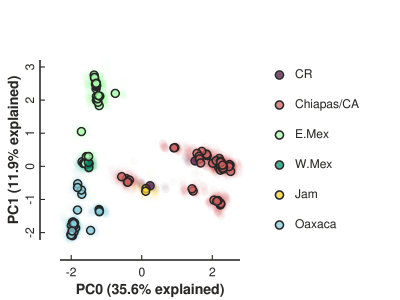

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          116
pre_filter_snps                              3419673
pre_filter_percent_missing                        67
filter_by_indels_present                           0
filter_by_non_biallelic                       129070
filter_by_mincov                             3416030
filter_by_minmap                             3153237
filter_by_invariant_after_subsampling        1611534
filter_by_minor_allele_frequency             2146978
post_filter_snps                                 226
post_filter_snp_containing_linkage_blocks         91
post_filter_percent_missing                        8
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:22
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 69.7%, 13.8%, 16.5%
INFO | snps_extract | subsampled 91 u

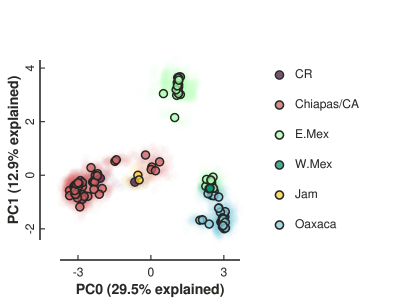

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          116
pre_filter_snps                              3419673
pre_filter_percent_missing                        67
filter_by_indels_present                           0
filter_by_non_biallelic                       129070
filter_by_mincov                             3411199
filter_by_minmap                             3153237
filter_by_invariant_after_subsampling        1611534
filter_by_minor_allele_frequency             2146978
post_filter_snps                                 697
post_filter_snp_containing_linkage_blocks        215
post_filter_percent_missing                       15
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:22
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 76.4%, 14.5%, 9.1%
INFO | snps_extract | subsampled 215 u

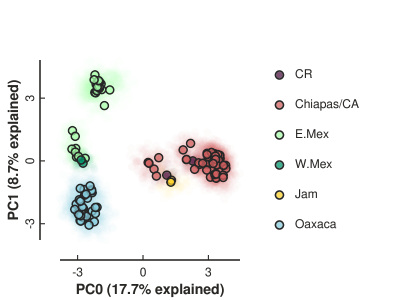

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          116
pre_filter_snps                              3419673
pre_filter_percent_missing                        67
filter_by_indels_present                           0
filter_by_non_biallelic                       129070
filter_by_mincov                             3392855
filter_by_minmap                             3153237
filter_by_invariant_after_subsampling        1611534
filter_by_minor_allele_frequency             2146978
post_filter_snps                                2931
post_filter_snp_containing_linkage_blocks        823
post_filter_percent_missing                       21
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:21
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 74.6%, 16.5%, 8.9%
INFO | snps_extract | subsampled 823 u

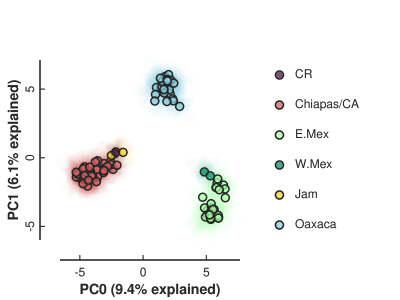

In [13]:
for mincov in [0.9, 0.85, 0.8, 0.75]:
    tool = ipa.pca(
        data=DATA,
        imap=imap_mex_central_america,
        minmap=0.5,
        mincov=mincov,
        minmaf=0.02,
        random_seed=123,
        cores=10,
    )
    tool.run(50, random_seed=333, subsample=True)
    canvas, axes, _ = tool.draw(
        colors=[region_colors[i] for i in imap_mex_central_america],
        size=8,
    );
    toyplot.png.render(canvas, f"./figures/Oreinotinus-CA-mincov-{mincov}.png")
    display(canvas)

### UMAP with imputation from apriori IMAP with mincov=0.75

INFO | snps_extract | subsampled 823 unlinked SNPs.


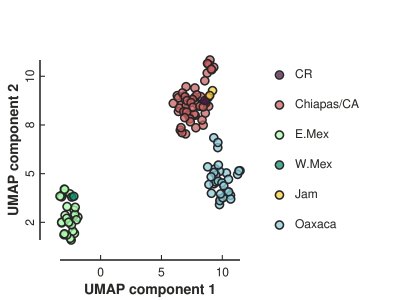

In [16]:
tool.run_umap(n_neighbors=4, min_dist=0.25, random_seed=333, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in imap_mex_central_america],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-CA-umap.png")
display(canvas)

### PCA with imputation from IMAP inferred by Kmeans for mincov in (0.75 - 0.9)

In [8]:
tool = ipa.pca(
    data=DATA,
    imap=imap_mex_central_america,
    minmap=0.5,
    mincov=0.75,
    minmaf=0.02,
    random_seed=123,
    cores=10,
    kmeans_clusters=6,
    kmeans_mincov_max=0.9,
    kmeans_niters=5,   
)

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          116
pre_filter_snps                              3419673
pre_filter_percent_missing                        67
filter_by_indels_present                           0
filter_by_non_biallelic                       129070
filter_by_mincov                             3417760
filter_by_minmap                             2662091
filter_by_invariant_after_subsampling        1611534
filter_by_minor_allele_frequency             2146978
post_filter_snps                                 114
post_filter_snp_containing_linkage_blocks         60
post_filter_percent_missing                        4
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:21
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 54.6%, 13.1%, 32.3%
INFO | snps_extract | subsampled 60 u

INFO | snps_extract | subsampled 577 unlinked SNPs.


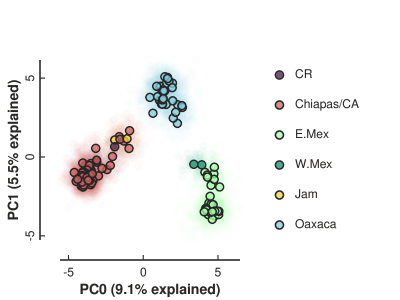

In [9]:
tool.run(50, random_seed=123, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in imap_mex_central_america],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-CA-kmeans.png")
display(canvas)

### UMAP with imputation from IMAP inferred by Kmeans for mincov in (0.75 - 0.9)

INFO | snps_extract | subsampled 577 unlinked SNPs.


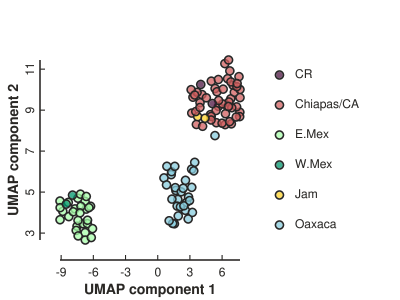

In [10]:
tool.run_umap(n_neighbors=5, min_dist=0.5, random_seed=333, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in imap_mex_central_america],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-CA-umap-kmeans.png")
display(canvas)

-------------------------------


------------------------------

# South America

In [7]:
select = ["W.Col", "S.Peru/Bol", "S.Ecu/N.Peru", "E.Col/Ven", "S.Col/N.Ecu"]
imap_south_america = {k: IMAP[k] for k in select}

### PCAs with imputation by IMAP *a priori* for mincov in (0.75 - 0.9)

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                           62
pre_filter_snps                              3419673
pre_filter_percent_missing                        57
filter_by_indels_present                           0
filter_by_non_biallelic                        72203
filter_by_mincov                             3391658
filter_by_minmap                             2670397
filter_by_invariant_after_subsampling        2381817
filter_by_minor_allele_frequency             2463579
post_filter_snps                                1786
post_filter_snp_containing_linkage_blocks        782
post_filter_percent_missing                        7
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:14
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 66.5%, 22.6%, 10.9%
INFO | snps_extract | subsampled 782 

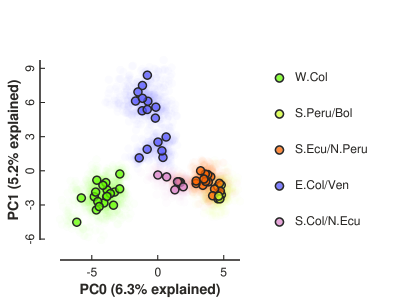

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                           62
pre_filter_snps                              3419673
pre_filter_percent_missing                        57
filter_by_indels_present                           0
filter_by_non_biallelic                        72203
filter_by_mincov                             3325867
filter_by_minmap                             2670397
filter_by_invariant_after_subsampling        2381817
filter_by_minor_allele_frequency             2463579
post_filter_snps                                6780
post_filter_snp_containing_linkage_blocks       2736
post_filter_percent_missing                       11
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:14
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 59.8%, 26.8%, 13.5%
INFO | snps_extract | subsampled 2736

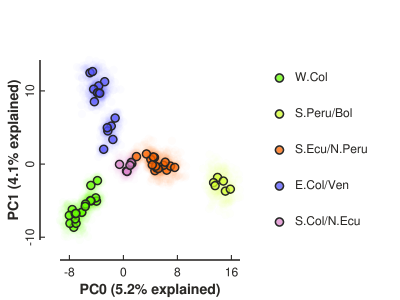

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                           62
pre_filter_snps                              3419673
pre_filter_percent_missing                        57
filter_by_indels_present                           0
filter_by_non_biallelic                        72203
filter_by_mincov                             3216943
filter_by_minmap                             2670397
filter_by_invariant_after_subsampling        2381817
filter_by_minor_allele_frequency             2463579
post_filter_snps                               18447
post_filter_snp_containing_linkage_blocks       6563
post_filter_percent_missing                       15
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:14
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 59.5%, 26.6%, 14.0%
INFO | snps_extract | subsampled 6563

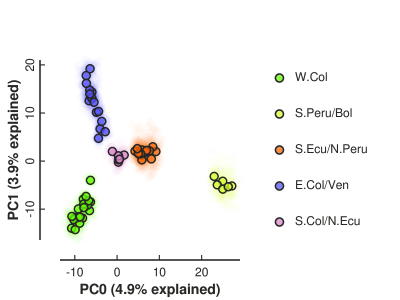

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                           62
pre_filter_snps                              3419673
pre_filter_percent_missing                        57
filter_by_indels_present                           0
filter_by_non_biallelic                        72203
filter_by_mincov                             3083036
filter_by_minmap                             2670397
filter_by_invariant_after_subsampling        2381817
filter_by_minor_allele_frequency             2463579
post_filter_snps                               37737
post_filter_snp_containing_linkage_blocks      11006
post_filter_percent_missing                       19
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:14
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 62.8%, 24.2%, 12.9%
INFO | snps_extract | subsampled 1100

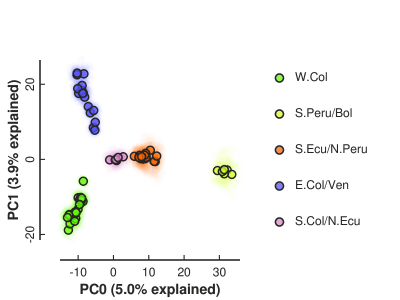

In [8]:
for mincov in [0.9, 0.85, 0.8, 0.75]:
    tool = ipa.pca(
        data=DATA,
        imap=imap_south_america,
        minmap=0.5,
        mincov=mincov,
        minmaf=0.02,
        random_seed=123,
        cores=10,
    )
    tool.run(50, random_seed=333, subsample=True)
    canvas, axes, _ = tool.draw(
        colors=[region_colors[i] for i in imap_south_america],
        size=8,
    );
    toyplot.png.render(canvas, f"./figures/Oreinotinus-SA-mincov-{mincov}.png")
    display(canvas)

### UMAP with imputation from apriori IMAP with mincov=0.75

INFO | snps_extract | subsampled 11006 unlinked SNPs.


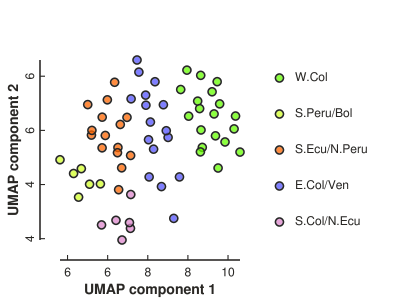

In [9]:
tool.run_umap(n_neighbors=10, min_dist=0.1, random_seed=333, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in imap_south_america],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-SA-umap.png")
display(canvas)

### PCA with imputation from IMAP inferred by Kmeans for mincov in (0.75 - 0.9)

In [15]:
tool = ipa.pca(
    data=DATA,
    imap=imap_south_america,
    minmap=0.5,
    mincov=0.75,
    minmaf=0.02,
    random_seed=333,
    cores=10,
    kmeans_clusters=3,
    kmeans_mincov_max=0.9,
    kmeans_niters=5,   
)

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                           62
pre_filter_snps                              3419673
pre_filter_percent_missing                        57
filter_by_indels_present                           0
filter_by_non_biallelic                        72203
filter_by_mincov                             3391658
filter_by_minmap                             1647084
filter_by_invariant_after_subsampling        2381817
filter_by_minor_allele_frequency             2463579
post_filter_snps                                1787
post_filter_snp_containing_linkage_blocks        782
post_filter_percent_missing                        7
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:14
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 66.2%, 23.5%, 10.3%
INFO | snps_extract | subsampled 782 

INFO | snps_extract | subsampled 8707 unlinked SNPs.


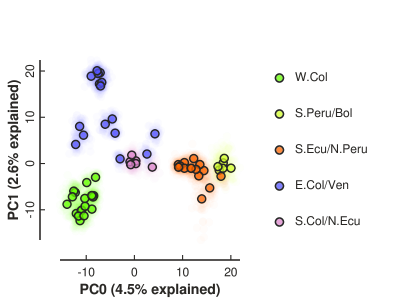

In [17]:
tool.run(50, random_seed=333, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in imap_south_america],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-SA-kmeans.png")
display(canvas)

### UMAP with imputation from IMAP inferred by Kmeans for mincov in (0.75 - 0.9)

INFO | snps_extract | subsampled 8707 unlinked SNPs.


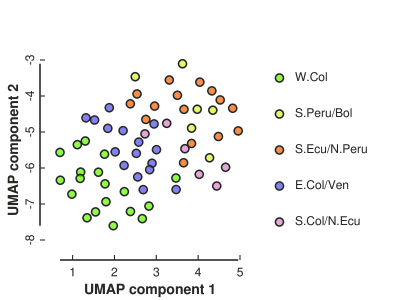

In [21]:
tool.run_umap(n_neighbors=10, min_dist=0.3, random_seed=333, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in imap_south_america],
    size=8,
);
axes.x.ticks.locator = toyplot.locator.Extended()
axes.y.ticks.locator = toyplot.locator.Extended()
toyplot.png.render(canvas, "./figures/Oreinotinus-SA-umap-kmeans.png")
display(canvas)

---------------------------------------------

----------------------------------------------

# All samples

### PCAs with imputation by IMAP *a priori* for mincov in (0.75 - 0.9)

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          178
pre_filter_snps                              3419673
pre_filter_percent_missing                        63
filter_by_indels_present                           0
filter_by_non_biallelic                       193270
filter_by_mincov                             3417640
filter_by_minmap                             3225437
filter_by_invariant_after_subsampling         908359
filter_by_minor_allele_frequency             2130075
post_filter_snps                                 123
post_filter_snp_containing_linkage_blocks         66
post_filter_percent_missing                        5
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:30
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 56.4%, 11.5%, 32.1%
INFO | snps_extract | subsampled 66 u

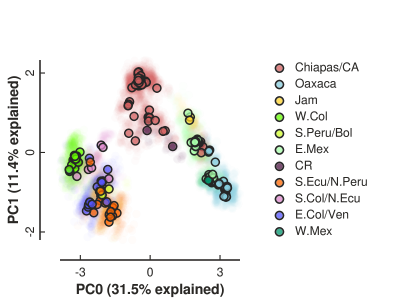

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          178
pre_filter_snps                              3419673
pre_filter_percent_missing                        63
filter_by_indels_present                           0
filter_by_non_biallelic                       193270
filter_by_mincov                             3415141
filter_by_minmap                             3225437
filter_by_invariant_after_subsampling         908359
filter_by_minor_allele_frequency             2130075
post_filter_snps                                 282
post_filter_snp_containing_linkage_blocks        115
post_filter_percent_missing                        9
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:30
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 71.6%, 13.2%, 15.3%
INFO | snps_extract | subsampled 115 

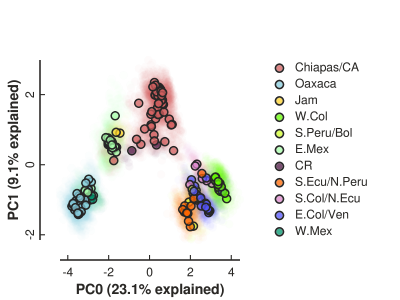

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          178
pre_filter_snps                              3419673
pre_filter_percent_missing                        63
filter_by_indels_present                           0
filter_by_non_biallelic                       193270
filter_by_mincov                             3403756
filter_by_minmap                             3225437
filter_by_invariant_after_subsampling         908359
filter_by_minor_allele_frequency             2130075
post_filter_snps                                1205
post_filter_snp_containing_linkage_blocks        408
post_filter_percent_missing                       16
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:30
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 76.6%, 14.9%, 8.6%
INFO | snps_extract | subsampled 408 u

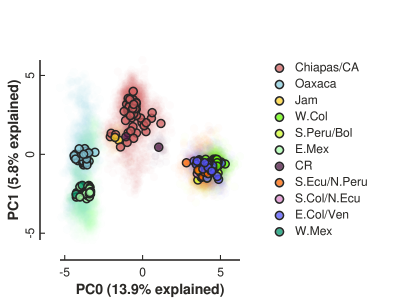

INFO | cluster.py   | Establishing parallel ipcluster: 10 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          178
pre_filter_snps                              3419673
pre_filter_percent_missing                        63
filter_by_indels_present                           0
filter_by_non_biallelic                       193270
filter_by_mincov                             3357698
filter_by_minmap                             3225437
filter_by_invariant_after_subsampling         908359
filter_by_minor_allele_frequency             2130075
post_filter_snps                                5497
post_filter_snp_containing_linkage_blocks       1843
post_filter_percent_missing                       21
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:30
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 73.0%, 17.3%, 9.7%
INFO | snps_extract | subsampled 1843 

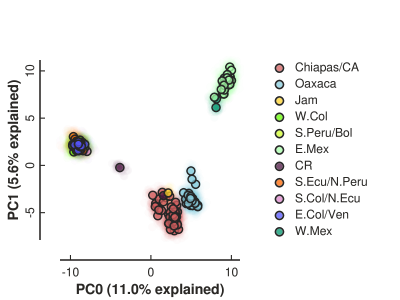

In [12]:
for mincov in [0.9, 0.85, 0.8, 0.75]:
    tool = ipa.pca(
        data=DATA,
        imap=IMAP,
        minmap=0.5,
        mincov=mincov,
        minmaf=0.02,
        random_seed=123,
        cores=10,
    )
    tool.run(50, random_seed=333, subsample=True)
    canvas, axes, _ = tool.draw(
        colors=[region_colors[i] for i in IMAP],
        size=8,
    );
    toyplot.png.render(canvas, f"./figures/Oreinotinus-full-mincov-{mincov}.png")
    display(canvas)

### UMAP with imputation from apriori IMAP with mincov=0.75

INFO | snps_extract | subsampled 1843 unlinked SNPs.


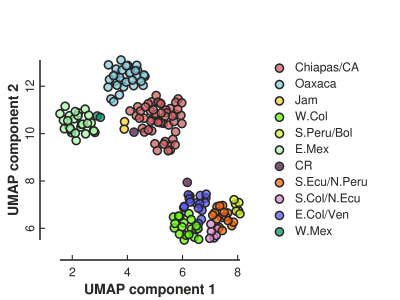

In [14]:
tool.run_umap(n_neighbors=55, random_seed=777, min_dist=0.25, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in IMAP],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-full-umap.png")
display(canvas)

### PCA with imputation from IMAP inferred by Kmeans for mincov in (0.75 - 0.9)

In [7]:
tool = ipa.pca(
    data=DATA,
    imap=IMAP,
    minmap=0.5,
    mincov=0.75,
    minmaf=0.02,
    random_seed=123,
    cores=20,
    kmeans_clusters=6,
    kmeans_mincov_max=0.85,
    kmeans_niters=5,   
)

INFO | cluster.py   | Establishing parallel ipcluster: 20 engines.
INFO | progress.py  | [####################] SNP filtering
INFO | snps_extract | filter statistics:
samples                                          178
pre_filter_snps                              3419673
pre_filter_percent_missing                        63
filter_by_indels_present                           0
filter_by_non_biallelic                       193270
filter_by_mincov                             3415141
filter_by_minmap                             2331823
filter_by_invariant_after_subsampling         908359
filter_by_minor_allele_frequency             2130075
post_filter_snps                                 318
post_filter_snp_containing_linkage_blocks        127
post_filter_percent_missing                        9
dtype: int64
INFO | cluster.py   | ipcluster stopped. Elapsed time: 0:00:23
INFO | snps_imputer | Imputation: sampled genotypes (0, 1, 2) = 72.4%, 14.6%, 12.9%
INFO | snps_extract | subsampled 127 

INFO | snps_extract | subsampled 2033 unlinked SNPs.


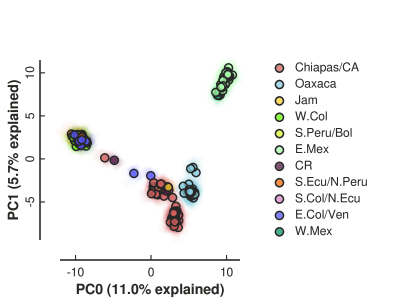

In [9]:
tool.run(50, random_seed=123, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in IMAP],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-full-kmeans.png")
display(canvas)

### UMAP with imputation from IMAP inferred by Kmeans for mincov in (0.75 - 0.9)

INFO | snps_extract | subsampled 2033 unlinked SNPs.


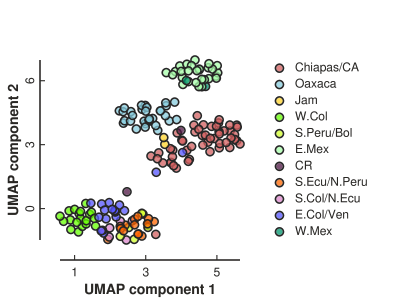

In [11]:
tool.run_umap(n_neighbors=55, random_seed=777, min_dist=0.25, subsample=True)
canvas, axes, _ = tool.draw(
    colors=[region_colors[i] for i in IMAP],
    size=8,
);
toyplot.png.render(canvas, "./figures/Oreinotinus-full-umap-kmeans.png")
display(canvas)